
# KOI → Light Curves → Transit Timelapse (5-sample MVP)

**Goal:** Starting from a KOI catalog (Excel), fetch **PDCSAP light curves**, enrich the table, and **visualize transits** — including a **timelapse** showing how measured light changes over an orbit.

**Sections**
1. Setup & config  
2. Load KOI sample (top 5)  
3. Fetch & preprocess light curves (PDCSAP)  
4. Enrich the KOI table with derived time-series features  
5. Visualize: (a) raw & phase‑folded LC, (b) BLS periodogram, (c) orbit–light timelapse  
6. (Optional) 3D orbit view linked to brightness

> This notebook expects your KOI Excel at: `data/Kepler Object of Interest.xlsx`.


In [1]:

# --- 1) Setup & config ---------------------------------------------------------
# If running in Colab, uncomment the next cell to install dependencies.
# (Lightkurve pulls Kepler data from MAST; requires internet at runtime.)

# !pip -q install lightkurve astroquery astropy pywavelets

import os
import math
import json
from pathlib import Path
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

plt.rcParams["figure.figsize"] = (7, 4)
plt.rcParams["axes.grid"] = True

try:
    import lightkurve as lk
    from astropy.timeseries import BoxLeastSquares
except Exception as e:
    print("Note: lightkurve/astropy not imported yet. Install them if you plan to fetch from MAST.")
    print(e)

from matplotlib.animation import FuncAnimation, PillowWriter
from IPython.display import HTML

try:
    import pywt
except Exception as e:
    print("Scalogram (pywt) optional. Install pywavelets if you want it.")
    print(e)

data_path = "data/Kepler Object of Interest.xlsx"  # << change to your file
out_dir = Path("outputs")
out_dir.mkdir(exist_ok=True, parents=True)

TOP_N = 5


Scalogram (pywt) optional. Install pywavelets if you want it.
No module named 'pywt'


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\prf\__init__.py:7: UserWarning: Warning: the tpfmodel submodule is not available without oktopus installed, which requires a current version of autograd. See #1452 for details.
  warnings.warn(


In [3]:
# --- 2) Load KOI sample (top 5) -----------------------------------------------

# Define which features and target we plan to use for model training
target_col = "koi_disposition"
feature_cols = [
    "koi_period", "koi_time0bk", "koi_duration", "koi_depth",
    "koi_prad", "koi_teq", "koi_steff", "koi_slogg", "koi_srad", "koi_kepmag"
]

def load_koi_sample(xlsx_path: str, top_n: int = 5) -> pd.DataFrame:
    """Load top N KOI rows, ensuring required training columns exist."""
    df = pd.read_excel(xlsx_path)
    df.columns = [str(c).strip().lower() for c in df.columns]

    required_cols = ["kepid", "kepoi_name", "kepler_name"] + feature_cols + [target_col]
    missing = [c for c in required_cols if c not in df.columns]
    if missing:
        raise ValueError(f"Missing columns in Excel: {missing}")

    df_subset = df[required_cols].head(top_n).copy()
    print(f"✅ Loaded {len(df_subset)} KOI records with all training fields present.")
    return df_subset

# Load the KOI sample
koi_df = load_koi_sample(data_path, TOP_N)

print("KOI sample (top rows):")
display(koi_df.head())


✅ Loaded 5 KOI records with all training fields present.
KOI sample (top rows):


,kepid,kepoi_name,kepler_name,koi_period,koi_time0bk,koi_duration,koi_depth,koi_prad,koi_teq,koi_steff,koi_slogg,koi_srad,koi_kepmag,koi_disposition
0,10797460,K00752.01,Kepler-227 b,9.488036,170.538750,2.95750,615.8,2.26,793.0,5455.0,4.467,0.927,15.347,CONFIRMED
1,10797460,K00752.02,Kepler-227 c,54.418383,162.513840,4.50700,874.8,2.83,443.0,5455.0,4.467,0.927,15.347,CONFIRMED
2,10811496,K00753.01,NaN,19.899140,175.850252,1.78220,10829.0,14.60,638.0,5853.0,4.544,0.868,15.436,CANDIDATE
3,10848459,K00754.01,NaN,1.736952,170.307565,2.40641,8079.2,33.46,1395.0,5805.0,4.564,0.791,15.597,FALSE POSITIVE
4,10854555,K00755.01,Kepler-664 b,2.525592,171.595550,1.65450,603.3,2.75,1406.0,6031.0,4.438,1.046,15.509,CONFIRMED


In [5]:

# --- 3) Fetch & preprocess light curves ---------------------------------------

def fetch_pdcsap_lightcurve(kic_id: int):
    """Download and return a stitched PDCSAP light curve for a given Kepler KIC ID."""
    try:
        sr = lk.search_lightcurvefile(f"KIC {kic_id}", mission="Kepler")
        if len(sr) == 0:
            print(f"No LC files found for KIC {kic_id}.")
            return None
        lcf = sr.download_all()
        if lcf is None:
            print(f"Download failed for KIC {kic_id}.")
            return None
        lc = lcf.PDCSAP_FLUX.stitch().remove_nans()
        lc = lc.flatten(window_length=401)
        return lc
    except Exception as e:
        print(f"Error fetching LC for KIC {kic_id}: {e}")
        return None


def compute_bls_periodogram(time, flux, min_period=0.5, max_period=100.0, n_samples=5000, duration_fraction=0.05):
    periods = np.linspace(min_period, max_period, n_samples)
    bls = BoxLeastSquares(time, flux)
    res = bls.power(periods, duration_fraction)
    best_idx = int(np.nanargmax(res.power))
    best_period = float(periods[best_idx])
    best_power  = float(res.power[best_idx])
    return periods, res.power, best_period, best_power



def fold_lightcurve(lc, period, t0):
    folded = lc.fold(period=period, t0=t0)
    return np.array(folded.time.value), np.array(folded.flux.value)


def compute_scalogram(time, flux, wavelet="morl", scales=np.arange(1, 128)):
    if "pywt" not in globals():
        return None
    coef, _ = pywt.cwt(flux, scales, wavelet)
    return coef


In [6]:

# --- 4) Enrich the KOI table with derived features ----------------------------

def derive_timeseries_features(lc, period=None, t0=None):
    if lc is None:
        return dict(
            lc_points=0, lc_flux_mean=np.nan, lc_flux_std=np.nan, lc_time_span_days=np.nan,
            bls_best_period=np.nan, bls_best_power=np.nan,
            folded_med_depth=np.nan, folded_odd_even_ratio=np.nan
        )
    t = lc.time.value
    y = lc.flux.value
    feats = dict(
        lc_points=int(len(y)),
        lc_flux_mean=float(np.nanmean(y)),
        lc_flux_std=float(np.nanstd(y)),
        lc_time_span_days=float(t.max() - t.min()),
        bls_best_period=np.nan,
        bls_best_power=np.nan,
        folded_med_depth=np.nan,
        folded_odd_even_ratio=np.nan,
    )
    # BLS
    try:
        periods, power, best_p, best_pow = compute_bls_periodogram(t, y)
        feats["bls_best_period"] = best_p
        feats["bls_best_power"]  = best_pow
    except Exception:
        pass
    # Folded stats (uses KOI period/epoch if provided)
    if period is not None and t0 is not None:
        try:
            folded = lc.fold(period=period, t0=t0)
            ph = np.array(folded.time.value)
            yf = np.array(folded.flux.value)
            # median depth around transit center (phase ~ 0)
            mask_in = np.abs(ph) < 0.1 * period  # crude window
            feats["folded_med_depth"] = float(np.nanmedian(yf[mask_in]) - np.nanmedian(yf[~mask_in]))
            # simple odd-even depth ratio to flag EBs
            # split by phase halves
            d1 = np.nanmedian(yf[(ph>=-0.25*period) & (ph<-0.0*period)])
            d2 = np.nanmedian(yf[(ph>=0.0*period)  & (ph< 0.25*period)])
            feats["folded_odd_even_ratio"] = float(d1/d2) if np.isfinite(d1) and np.isfinite(d2) and d2!=0 else np.nan
        except Exception:
            pass
    return feats



def enrich_koi_with_lc(koi_df: pd.DataFrame) -> pd.DataFrame:
    """
    For each KOI row:
      - fetch PDCSAP light curve
      - compute signal features (incl. BLS best period/power, folded stats)
      - save plots (raw, folded, BLS, optional scalogram)
      - return an enriched dataframe (original columns + LC features + artifact paths)
    """
    records = []
    for _, row in koi_df.iterrows():
        kic = int(row["kepid"])
        period = float(row["koi_period"])
        t0 = float(row["koi_time0bk"])

        print(f"Processing KIC {kic} | P ~ {period} d | t0 ~ {t0} BKJD")
        lc = fetch_pdcsap_lightcurve(kic)

        # --- derive features (now uses period/t0 for folded stats) ---
        feats = derive_timeseries_features(lc, period=period, t0=t0)

        # Container for file artifacts
        art = {"plots": {}, "animation": None}

        if lc is not None:
            # --- Raw LC plot ---
            fig = plt.figure()
            plt.plot(lc.time.value, lc.flux.value, linewidth=0.7)
            plt.xlabel("Time [BKJD]"); plt.ylabel("Normalized Flux")
            plt.title(f"KIC {kic} — PDCSAP (detrended)")
            pth = str((out_dir / f"kic_{kic}_raw_lc.png").resolve())
            plt.tight_layout(); plt.savefig(pth, dpi=160); plt.close(fig)
            art["plots"]["raw_lc"] = pth

            # --- Phase-folded plot ---
            ph, f = fold_lightcurve(lc, period, t0)
            fig2 = plt.figure()
            plt.scatter(ph, f, s=2, alpha=0.3)
            plt.xlabel("Phase [days]"); plt.ylabel("Flux")
            plt.title(f"KIC {kic} — Phase-folded ({period:.3f} d)")
            pth2 = str((out_dir / f"kic_{kic}_folded.png").resolve())
            plt.tight_layout(); plt.savefig(pth2, dpi=160); plt.close(fig2)
            art["plots"]["folded"] = pth2

            # --- BLS periodogram (now also returns best period/power) ---
            periods, power, best_p, best_pow = compute_bls_periodogram(
                lc.time.value, lc.flux.value
            )
            # Stash best BLS values into feature dict if not already set
            feats.setdefault("bls_best_period", float(best_p))
            feats.setdefault("bls_best_power", float(best_pow))

            fig3 = plt.figure()
            plt.plot(periods, power, linewidth=0.7)
            plt.xlabel("Trial Period [days]"); plt.ylabel("BLS Power")
            plt.title(f"KIC {kic} — BLS periodogram (best ≈ {best_p:.3f} d)")
            pth3 = str((out_dir / f"kic_{kic}_bls.png").resolve())
            plt.tight_layout(); plt.savefig(pth3, dpi=160); plt.close(fig3)
            art["plots"]["bls"] = pth3

            # --- Optional: Wavelet scalogram ---
            try:
                coef = compute_scalogram(lc.time.value, lc.flux.value)
                if coef is not None:
                    fig4 = plt.figure()
                    plt.imshow(coef, aspect="auto", origin="lower")
                    plt.xlabel("Time Index"); plt.ylabel("Scale")
                    plt.title(f"KIC {kic} — Wavelet Scalogram")
                    pth4 = str((out_dir / f"kic_{kic}_scalogram.png").resolve())
                    plt.tight_layout(); plt.savefig(pth4, dpi=160); plt.close(fig4)
                    art["plots"]["scalogram"] = pth4
            except Exception as e:
                print("Scalogram skipped:", e)

            # --- Optional: persist compact time series for ML (npz) ---
            # npz_path = (out_dir / f"kic_{kic}_pdcsap.npz")
            # np.savez_compressed(npz_path, time=lc.time.value, flux=lc.flux.value)
            # art["timeseries_npz"] = str(npz_path.resolve())

        # Merge original KOI columns + features + artifacts
        rec = row.to_dict()
        rec.update(feats)
        rec["artifacts"] = json.dumps(art)
        records.append(rec)

    enriched = pd.DataFrame(records)
    return enriched


enriched_df = enrich_koi_with_lc(koi_df)
print("\nEnriched KOI table (preview):")
display(enriched_df.head())

enriched_csv = out_dir / "koi_enriched_5sample.csv"
enriched_df.to_csv(enriched_csv, index=False)
print("Saved:", enriched_csv.resolve())


Processing KIC 10797460 | P ~ 9.48803557 d | t0 ~ 170.53875 BKJD


C:\Users\roger\AppData\Local\Temp\ipykernel_24116\392714202.py:6: LightkurveDeprecationWarning: The search_lightcurvefile function is deprecated and may be removed in a future version.
        Use search_lightcurve() instead.
  sr = lk.search_lightcurvefile(f"KIC {kic_id}", mission="Kepler")
C:\Users\roger\AppData\Local\Temp\ipykernel_24116\392714202.py:14: LightkurveDeprecationWarning: The PDCSAP_FLUX function is deprecated and may be removed in a future version.
  lc = lcf.PDCSAP_FLUX.stitch().remove_nans()
c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\collections.py:163: LightkurveDeprecationWarning: The PDCSAP_FLUX function is deprecated and may be removed in a future version.
  return LightCurveCollection([lc.PDCSAP_FLUX for lc in self])
c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\astropy\utils\decorators.py:620: LightkurveDeprecationWarning: "t0" was deprecated in version 2.0 and will be removed in a future versio

Processing KIC 10797460 | P ~ 54.4183827 d | t0 ~ 162.51384 BKJD


C:\Users\roger\AppData\Local\Temp\ipykernel_24116\392714202.py:6: LightkurveDeprecationWarning: The search_lightcurvefile function is deprecated and may be removed in a future version.
        Use search_lightcurve() instead.
  sr = lk.search_lightcurvefile(f"KIC {kic_id}", mission="Kepler")
C:\Users\roger\AppData\Local\Temp\ipykernel_24116\392714202.py:14: LightkurveDeprecationWarning: The PDCSAP_FLUX function is deprecated and may be removed in a future version.
  lc = lcf.PDCSAP_FLUX.stitch().remove_nans()
c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\collections.py:163: LightkurveDeprecationWarning: The PDCSAP_FLUX function is deprecated and may be removed in a future version.
  return LightCurveCollection([lc.PDCSAP_FLUX for lc in self])
c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\astropy\utils\decorators.py:620: LightkurveDeprecationWarning: "t0" was deprecated in version 2.0 and will be removed in a future versio

Processing KIC 10811496 | P ~ 19.89913995 d | t0 ~ 175.850252 BKJD


C:\Users\roger\AppData\Local\Temp\ipykernel_24116\392714202.py:6: LightkurveDeprecationWarning: The search_lightcurvefile function is deprecated and may be removed in a future version.
        Use search_lightcurve() instead.
  sr = lk.search_lightcurvefile(f"KIC {kic_id}", mission="Kepler")
C:\Users\roger\AppData\Local\Temp\ipykernel_24116\392714202.py:14: LightkurveDeprecationWarning: The PDCSAP_FLUX function is deprecated and may be removed in a future version.
  lc = lcf.PDCSAP_FLUX.stitch().remove_nans()
c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\collections.py:163: LightkurveDeprecationWarning: The PDCSAP_FLUX function is deprecated and may be removed in a future version.
  return LightCurveCollection([lc.PDCSAP_FLUX for lc in self])
c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\astropy\utils\decorators.py:620: LightkurveDeprecationWarning: "t0" was deprecated in version 2.0 and will be removed in a future versio

Processing KIC 10848459 | P ~ 1.736952453 d | t0 ~ 170.307565 BKJD


C:\Users\roger\AppData\Local\Temp\ipykernel_24116\392714202.py:6: LightkurveDeprecationWarning: The search_lightcurvefile function is deprecated and may be removed in a future version.
        Use search_lightcurve() instead.
  sr = lk.search_lightcurvefile(f"KIC {kic_id}", mission="Kepler")
C:\Users\roger\AppData\Local\Temp\ipykernel_24116\392714202.py:14: LightkurveDeprecationWarning: The PDCSAP_FLUX function is deprecated and may be removed in a future version.
  lc = lcf.PDCSAP_FLUX.stitch().remove_nans()
c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\collections.py:163: LightkurveDeprecationWarning: The PDCSAP_FLUX function is deprecated and may be removed in a future version.
  return LightCurveCollection([lc.PDCSAP_FLUX for lc in self])
c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\astropy\utils\decorators.py:620: LightkurveDeprecationWarning: "t0" was deprecated in version 2.0 and will be removed in a future versio

Processing KIC 10854555 | P ~ 2.525591777 d | t0 ~ 171.59555 BKJD


C:\Users\roger\AppData\Local\Temp\ipykernel_24116\392714202.py:6: LightkurveDeprecationWarning: The search_lightcurvefile function is deprecated and may be removed in a future version.
        Use search_lightcurve() instead.
  sr = lk.search_lightcurvefile(f"KIC {kic_id}", mission="Kepler")
C:\Users\roger\AppData\Local\Temp\ipykernel_24116\392714202.py:14: LightkurveDeprecationWarning: The PDCSAP_FLUX function is deprecated and may be removed in a future version.
  lc = lcf.PDCSAP_FLUX.stitch().remove_nans()
c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\collections.py:163: LightkurveDeprecationWarning: The PDCSAP_FLUX function is deprecated and may be removed in a future version.
  return LightCurveCollection([lc.PDCSAP_FLUX for lc in self])
c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\astropy\utils\decorators.py:620: LightkurveDeprecationWarning: "t0" was deprecated in version 2.0 and will be removed in a future versio


Enriched KOI table (preview):


,kepid,kepoi_name,kepler_name,koi_period,koi_time0bk,koi_duration,koi_depth,koi_prad,koi_teq,koi_steff,...,koi_disposition,lc_points,lc_flux_mean,lc_flux_std,lc_time_span_days,bls_best_period,bls_best_power,folded_med_depth,folded_odd_even_ratio,artifacts
0,10797460,K00752.01,Kepler-227 b,9.488036,170.538750,2.95750,615.8,2.26,793.0,5455.0,...,CONFIRMED,64814,1.000003,0.000550,1459.489221,54.419884,0.000023,-0.000019,1.000021,"{""plots"": {""raw_lc"": ""C:\\Roger\\goals\\creati..."
1,10797460,K00752.02,Kepler-227 c,54.418383,162.513840,4.50700,874.8,2.83,443.0,5455.0,...,CONFIRMED,64814,1.000003,0.000550,1459.489221,54.419884,0.000023,-0.000002,1.000002,"{""plots"": {""raw_lc"": ""C:\\Roger\\goals\\creati..."
2,10811496,K00753.01,NaN,19.899140,175.850252,1.78220,10829.0,14.60,638.0,5853.0,...,CANDIDATE,51731,1.000103,0.003846,1459.489183,6.849370,0.001296,-0.000130,1.000013,"{""plots"": {""raw_lc"": ""C:\\Roger\\goals\\creati..."
3,10848459,K00754.01,NaN,1.736952,170.307565,2.40641,8079.2,33.46,1395.0,5805.0,...,FALSE POSITIVE,51502,0.999754,0.001490,1459.489290,13.895379,0.004798,-0.000374,0.999921,"{""plots"": {""raw_lc"": ""C:\\Roger\\goals\\creati..."
4,10854555,K00755.01,Kepler-664 b,2.525592,171.595550,1.65450,603.3,2.75,1406.0,6031.0,...,CONFIRMED,284601,1.000008,0.002249,1421.236441,74.323865,0.000168,0.000000,1.000000,"{""plots"": {""raw_lc"": ""C:\\Roger\\goals\\creati..."


Saved: C:\Roger\goals\creating\blog\NASA-Space-Apps\outputs\koi_enriched_5sample.csv


In [10]:
# --- 5) Orbit–Light timelapse for a single KOI --------------------------------

def make_orbit_light_animation(kic: int, lc, period: float, t0: float, frames: int = 200, save_path=None):
    if lc is None:
        print("No light curve available for animation.")
        return None

    # Coerce to plain float arrays (handle astropy Quantity & masked arrays)
    t = np.asarray(getattr(lc.time, "value", lc.time), dtype=float)
    y = getattr(lc, "flux", None)
    if y is None:
        print("No flux in light curve.")
        return None
    y = getattr(y, "value", y)                         # Quantity -> ndarray
    y = np.ma.getdata(y).astype(float, copy=False)     # Masked -> plain ndarray

    # Guards
    if not np.isfinite(period) or period <= 0:
        print("Invalid period for animation.")
        return None
    if t.size < 2 or y.size < 2:
        print("Not enough points to animate.")
        return None

    # Phase within each period and sort
    t_rel = (t - float(t0)) % float(period)
    order = np.argsort(t_rel)
    t_rel, y = t_rel[order], y[order]
    if t_rel.size < 5:
        print("Too few phase points to animate.")
        return None

    fig = plt.figure(figsize=(6.5, 7.5))
    gs = fig.add_gridspec(2, 1, height_ratios=[2.0, 1.0])
    ax_orbit = fig.add_subplot(gs[0], aspect="equal")
    ax_flux  = fig.add_subplot(gs[1])

    # Orbit panel
    star = plt.Circle((0, 0), 1.0, alpha=1.0)
    ax_orbit.add_artist(star)
    orbit_r = 3.0
    th = np.linspace(0, 2*np.pi, 512)
    ax_orbit.plot(orbit_r*np.cos(th), orbit_r*np.sin(th), linewidth=1.0)
    planet, = ax_orbit.plot([], [], marker='o', markersize=8)
    ax_orbit.set_xlim(-3.5, 3.5); ax_orbit.set_ylim(-3.5, 3.5)
    ax_orbit.set_xticks([]); ax_orbit.set_yticks([])
    ax_orbit.set_title(f"KIC {kic} — orbit (schematic)")

    # Flux panel
    ax_flux.plot(t_rel, y, linewidth=0.6)
    tracker_line = ax_flux.axvline(0.0, linestyle="--", linewidth=1.0)
    ax_flux.set_xlabel("Phase within period [days]")
    ax_flux.set_ylabel("Flux (normalized)")
    ax_flux.set_title("Measured flux vs phase (PDCSAP)")

    # Robust brightness→alpha mapping (plain floats only)
    finite_y = y[np.isfinite(y)]
    if finite_y.size < 5:
        print("Too few finite flux samples to animate.")
        return None
    q1, q2 = np.nanpercentile(finite_y, [1, 99])
    span = q2 - q1 if np.isfinite(q2 - q1) else 0.0

    def flux_to_alpha(f):
        if not np.isfinite(f) or span < 1e-8:
            return 1.0
        x = (float(f) - q1) / span
        return float(np.clip(0.3 + 0.7 * x, 0.0, 1.0))

    # Cap frames to available samples to avoid index errors
    frames_eff = int(min(frames, max(10, t_rel.size)))

    def update(i):
        idx = int((i / (frames_eff - 1)) * (t_rel.size - 1))
        phase_now = float(t_rel[idx])
        angle = (phase_now / float(period)) * 2 * np.pi
        xp = orbit_r * np.cos(angle); yp = orbit_r * np.sin(angle)

        planet.set_data([xp], [yp])
        tracker_line.set_xdata([phase_now, phase_now])
        star.set_alpha(flux_to_alpha(y[idx]))
        return planet, tracker_line, star

    anim = FuncAnimation(fig, update, frames=frames_eff, interval=40, blit=False)
    plt.tight_layout()
    if save_path is not None:
        try:
            anim.save(save_path, writer=PillowWriter(fps=25))
            print("Saved animation:", save_path)
        except Exception as e:
            print("Could not save animation. Error:", e)
    plt.close(fig)
    return anim

# Demo on first KOI if available
if len(enriched_df) > 0:
    row0 = enriched_df.iloc[2]
    kic0 = int(row0["kepid"])
    p0   = float(row0["koi_period"])
    t00  = float(row0["koi_time0bk"])

    print(f"Building animation for KIC {kic0} ...")
    lc0 = fetch_pdcsap_lightcurve(kic0)  # ensure this uses lk.search_lightcurve(...) in your fetch helper
    gif_path = str((out_dir / f"kic_{kic0}_orbit_light.gif").resolve())
    anim0 = make_orbit_light_animation(kic0, lc0, p0, t00, frames=240, save_path=gif_path)
    if anim0 is not None:
        display(HTML(anim0.to_jshtml()))



Building animation for KIC 10811496 ...


C:\Users\roger\AppData\Local\Temp\ipykernel_24116\392714202.py:6: LightkurveDeprecationWarning: The search_lightcurvefile function is deprecated and may be removed in a future version.
        Use search_lightcurve() instead.
  sr = lk.search_lightcurvefile(f"KIC {kic_id}", mission="Kepler")
C:\Users\roger\AppData\Local\Temp\ipykernel_24116\392714202.py:14: LightkurveDeprecationWarning: The PDCSAP_FLUX function is deprecated and may be removed in a future version.
  lc = lcf.PDCSAP_FLUX.stitch().remove_nans()
c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\collections.py:163: LightkurveDeprecationWarning: The PDCSAP_FLUX function is deprecated and may be removed in a future version.
  return LightCurveCollection([lc.PDCSAP_FLUX for lc in self])


Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\outputs\kic_10811496_orbit_light.gif


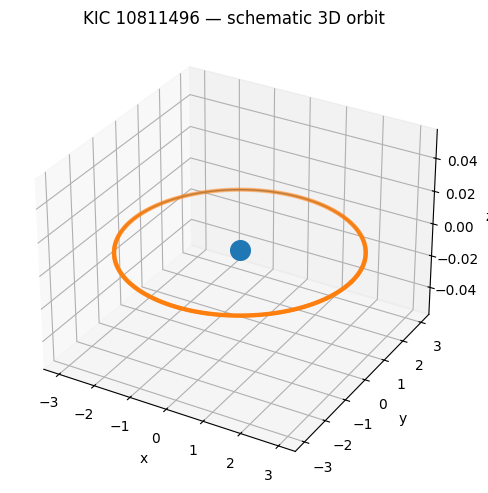

In [12]:

# --- 6) Optional: simple 3D orbit view ----------------------------------------

def quick_orbit_3d(kic, period, n_points=400):
    from mpl_toolkits.mplot3d import Axes3D  # noqa: F401
    fig = plt.figure(figsize=(6, 5))
    ax = fig.add_subplot(111, projection='3d')

    ax.scatter([0],[0],[0], s=200)

    r = 3.0
    th = np.linspace(0, 2*np.pi, n_points)
    x = r*np.cos(th); y = r*np.sin(th); z = np.zeros_like(th)
    ax.plot(x, y, z, linewidth=1.0)
    ax.scatter(x, y, z, s=5)

    ax.set_title(f"KIC {kic} — schematic 3D orbit")
    ax.set_xlabel("x"); ax.set_ylabel("y"); ax.set_zlabel("z")
    plt.tight_layout(); plt.show()

# Example:
quick_orbit_3d(kic0, p0)


In [14]:
# --- 6) 3D orbit + flux timelapse (synchronized) ------------------------------

from mpl_toolkits.mplot3d import Axes3D  # noqa: F401
from matplotlib.animation import FuncAnimation, PillowWriter

def make_orbit_light_animation_3d(
    kic: int, lc, period: float, t0: float,
    frames: int = 300, orbit_radius: float = 3.0, save_path=None,
    rotate_camera=True, rot_per_anim=0.6, elev_deg=22
):
    """
    3D orbit (top) + measured PDCSAP flux vs phase (bottom), synchronized.

    - The planet marker advances along a circular 3D orbit.
    - The vertical tracker on the flux plot moves at the same phase.
    - The star's opacity reflects instantaneous flux (dimmer at deeper dips).

    Params
    ------
    kic : KIC id
    lc : LightCurve (lightkurve)
    period : days
    t0 : epoch (BKJD)
    frames : animation frames
    orbit_radius : schematic radius for the drawn orbit
    save_path : optional path for GIF (uses PillowWriter)
    rotate_camera : if True, azimuth rotates during the animation
    rot_per_anim : revolutions of the camera per full animation (0.6 ~ 216°)
    elev_deg : camera elevation (degrees)
    """
    if lc is None:
        print("No light curve available for animation.")
        return None

    # --- Prepare arrays (plain floats, handle masked/quantities) ---
    t = np.asarray(getattr(lc.time, "value", lc.time), dtype=float)
    y = getattr(lc, "flux", None)
    if y is None:
        print("No flux in light curve.")
        return None
    y = getattr(y, "value", y)
    y = np.ma.getdata(y).astype(float, copy=False)

    if not np.isfinite(period) or period <= 0 or t.size < 2 or y.size < 2:
        print("Invalid LC/period for animation.")
        return None

    # Phase-fold & sort for smooth traversal
    t_rel = (t - float(t0)) % float(period)
    order = np.argsort(t_rel)
    t_rel, y = t_rel[order], y[order]
    if t_rel.size < 10:
        print("Too few samples to animate.")
        return None

    # Robust brightness -> alpha mapping
    finite_y = y[np.isfinite(y)]
    if finite_y.size < 10:
        print("Too few finite flux samples to animate.")
        return None
    q1, q2 = np.nanpercentile(finite_y, [1, 99])
    span = q2 - q1 if np.isfinite(q2 - q1) else 0.0

    def flux_to_alpha(f):
        if not np.isfinite(f) or span < 1e-8:
            return 1.0
        x = (float(f) - q1) / span
        return float(np.clip(0.3 + 0.7 * x, 0.0, 1.0))

    frames_eff = int(min(frames, max(20, t_rel.size)))

    # --- Figure layout (3D top + 2D bottom) ---
    fig = plt.figure(figsize=(7.2, 8.4))
    gs = fig.add_gridspec(2, 1, height_ratios=[2.0, 1.0])

    ax3d = fig.add_subplot(gs[0], projection='3d')
    axlc = fig.add_subplot(gs[1])

    # 3D orbit scaffolding
    th = np.linspace(0, 2*np.pi, 600)
    x_orb = orbit_radius*np.cos(th)
    y_orb = orbit_radius*np.sin(th)
    z_orb = np.zeros_like(th)
    ax3d.plot(x_orb, y_orb, z_orb, lw=1.5, color="tab:orange", alpha=0.9)

    # Star (scatter so we can set alpha dynamically)
    star = ax3d.scatter([0],[0],[0], s=600, color="tab:blue", alpha=1.0)

    # Planet marker (updated every frame)
    planet = ax3d.scatter([orbit_radius],[0],[0], s=60, color="tab:orange")

    # Nice view box
    lim = orbit_radius*1.25
    ax3d.set_xlim(-lim, lim); ax3d.set_ylim(-lim, lim); ax3d.set_zlim(-lim*0.2, lim*0.2)
    ax3d.set_xlabel("x"); ax3d.set_ylabel("y"); ax3d.set_zlabel("z")
    ax3d.set_title(f"KIC {kic} — schematic 3D orbit", pad=12)
    ax3d.view_init(elev=elev_deg, azim=45)

    # Flux plot
    axlc.plot(t_rel, y, lw=0.6)
    tracker = axlc.axvline(0.0, ls="--", lw=1.0)
    axlc.set_xlabel("Phase within period [days]")
    axlc.set_ylabel("Flux (normalized)")
    axlc.set_title("Measured flux vs phase (PDCSAP)")

    def update(i):
        # Index into folded series
        idx = int((i / (frames_eff - 1)) * (t_rel.size - 1))
        phase_now = float(t_rel[idx])
        angle = (phase_now / float(period)) * 2*np.pi

        # Planet position on circular orbit (in x–y plane)
        xp = orbit_radius*np.cos(angle)
        yp = orbit_radius*np.sin(angle)
        zp = 0.0

        # Update artists
        planet._offsets3d = ([xp], [yp], [zp])
        tracker.set_xdata([phase_now, phase_now])

        # Star brightness follows flux
        a = flux_to_alpha(y[idx])
        star.set_alpha(a)

        # Optional camera rotation for depth perception
        if rotate_camera:
            ax3d.view_init(elev=elev_deg, azim=45 + 360*rot_per_anim*(i/frames_eff))

        return planet, tracker, star

    anim = FuncAnimation(fig, update, frames=frames_eff, interval=35, blit=False)
    plt.tight_layout()
    if save_path:
        try:
            anim.save(save_path, writer=PillowWriter(fps=25))
            print("Saved animation:", save_path)
        except Exception as e:
            print("Could not save 3D animation. Error:", e)
    plt.close(fig)
    return anim

# Example run on your first KOI row (same inputs you already used)
if len(enriched_df) > 0:
    row0 = enriched_df.iloc[0]
    kic0 = int(row0["kepid"])
    p0   = float(row0["koi_period"])
    t00  = float(row0["koi_time0bk"])
    lc0  = fetch_pdcsap_lightcurve(kic0)

    print(f"Building 3D animation for KIC {kic0} ...")
    gif3d_path = str((out_dir / f"kic_{kic0}_orbit_light_3d.gif").resolve())
    anim3d = make_orbit_light_animation_3d(kic0, lc0, p0, t00, frames=300, save_path=gif3d_path)
    if anim3d is not None:
        display(HTML(anim3d.to_jshtml()))


C:\Users\roger\AppData\Local\Temp\ipykernel_24116\392714202.py:6: LightkurveDeprecationWarning: The search_lightcurvefile function is deprecated and may be removed in a future version.
        Use search_lightcurve() instead.
  sr = lk.search_lightcurvefile(f"KIC {kic_id}", mission="Kepler")
C:\Users\roger\AppData\Local\Temp\ipykernel_24116\392714202.py:14: LightkurveDeprecationWarning: The PDCSAP_FLUX function is deprecated and may be removed in a future version.
  lc = lcf.PDCSAP_FLUX.stitch().remove_nans()
c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\collections.py:163: LightkurveDeprecationWarning: The PDCSAP_FLUX function is deprecated and may be removed in a future version.
  return LightCurveCollection([lc.PDCSAP_FLUX for lc in self])


Building 3D animation for KIC 10797460 ...
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\outputs\kic_10797460_orbit_light_3d.gif


Animation size has reached 20981921 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [7]:
# --- Where Lightkurve stores downloads ----------------------------------------
from pathlib import Path
import os
print("Lightkurve cache dir:", Path(os.environ.get("LIGHTKURVE_DOWNLOAD_DIR", "cache/lightkurve")).resolve())

# --- Single-KIC smoke test → 3D_Orbit/kic_<KIC>_orbit_light_3d.gif -------------
import pandas as pd

# Load your confirmed set
df = pd.read_csv("data/koi_testing_sample/test_predictions_ensemble_confirmed.csv")

# Column aliases (adjust if your headers differ)
KIC_COLS   = ["kepid", "KIC", "kic", "Star System"]
PER_COLS   = ["koi_period", "period", "orbital_period_days"]
EPOCH_COLS = ["koi_time0bk", "epoch_bkjd", "t0_bkjd", "t0"]

def get_col(row, names, cast=float):
    for n in names:
        if n in row and pd.notna(row[n]):
            try:
                return cast(row[n])
            except Exception:
                pass
    return None

# Find first usable row
row0 = None
for _, r in df.iterrows():
    kic0 = get_col(r, KIC_COLS,   cast=int)
    p0   = get_col(r, PER_COLS,   cast=float)
    t00  = get_col(r, EPOCH_COLS, cast=float)
    if kic0 is not None and p0 is not None and t00 is not None:
        row0 = (kic0, p0, t00)
        break

assert row0 is not None, "No usable row found (needs KIC, period, t0 columns)."
kic0, p0, t00 = row0

# Fetch LC and make a single GIF
lc0 = fetch_pdcsap_lightcurve(int(kic0))  # or mode="all" for more coverage (slower)
out_dir = Path("3D_Orbit"); out_dir.mkdir(parents=True, exist_ok=True)
gif_path = (out_dir / f"kic_{int(kic0)}_orbit_light_3d.gif").resolve()
print(f"Saving test GIF → {gif_path}")

anim0 = make_orbit_light_animation_3d(
    kic=int(kic0), lc=lc0, period=float(p0), t0=float(t00),
    frames=120, rotate_camera=False, save_path=str(gif_path)
)

# --- Batch: first 30 rows → 3D_Orbit/ -----------------------------------------
built, skipped = 0, 0
max_n = min(30, len(df))

for idx, r in df.iloc[:max_n].iterrows():
    kic   = get_col(r, KIC_COLS,   cast=int)
    period = get_col(r, PER_COLS,   cast=float)
    t0     = get_col(r, EPOCH_COLS, cast=float)

    if kic is None or period is None or t0 is None:
        print(f"[skip idx={idx}] Missing kic/period/t0")
        skipped += 1
        continue

    lc = fetch_pdcsap_lightcurve(int(kic))  # or mode="all"
    if lc is None:
        print(f"[skip KIC {kic}] No light curve returned.")
        skipped += 1
        continue

    out_path = (out_dir / f"kic_{int(kic)}_orbit_light_3d.gif").resolve()
    print(f"▶ Building GIF for KIC {kic} → {out_path}")
    try:
        anim = make_orbit_light_animation_3d(
            kic=int(kic), lc=lc, period=float(period), t0=float(t0),
            frames=120, rotate_camera=False, save_path=str(out_path)
        )
        if anim is None:
            skipped += 1
        else:
            built += 1
    except Exception as e:
        print(f"[skip KIC {kic}] Error: {e}")
        skipped += 1

print(f"Done. Built {built} GIF(s), skipped {skipped}. Output dir: {out_dir.resolve()}")


Lightkurve cache dir: C:\Roger\goals\creating\blog\NASA-Space-Apps\cache\lightkurve
Saving test GIF → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_6343170_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 7 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_6343170_orbit_light_3d.gif
▶ Building GIF for KIC 6343170 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_6343170_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 7 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_6343170_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 17 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 8164012 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_8164012_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_8164012_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 18 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 11512246 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_11512246_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_11512246_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 17 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 1849702 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_1849702_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_1849702_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 17 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 10468885 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_10468885_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_10468885_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 18 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 5780885 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_5780885_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_5780885_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 10 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 9022166 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_9022166_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_9022166_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 17 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 5175024 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_5175024_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_5175024_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 17 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 6392727 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_6392727_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_6392727_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 17 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 3103227 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_3103227_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_3103227_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 18 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 8013439 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_8013439_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_8013439_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 17 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 10723367 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_10723367_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_10723367_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 14 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 10545066 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_10545066_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_10545066_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 17 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 3847138 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_3847138_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_3847138_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 18 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 4548098 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_4548098_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_4548098_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 15 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 11394027 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_11394027_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_11394027_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 17 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 9898017 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_9898017_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_9898017_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 14 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 3234843 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_3234843_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_3234843_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 17 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 3942670 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_3942670_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_3942670_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 17 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 9941859 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_9941859_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_9941859_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 18 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 6922244 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_6922244_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_6922244_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 17 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 11402995 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_11402995_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_11402995_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 17 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 9475552 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_9475552_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_9475552_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 8 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 9730163 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_9730163_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_9730163_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 14 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 9112931 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_9112931_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_9112931_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 14 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 10153855 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_10153855_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_10153855_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 7 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 9823519 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_9823519_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_9823519_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 17 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 10925104 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_10925104_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_10925104_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 17 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 9892816 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_9892816_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_9892816_orbit_light_3d.gif


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 18 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


▶ Building GIF for KIC 9881662 → C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_9881662_orbit_light_3d.gif
Saved animation: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit\kic_9881662_orbit_light_3d.gif
Done. Built 30 GIF(s), skipped 0. Output dir: C:\Roger\goals\creating\blog\NASA-Space-Apps\3D_Orbit


In [4]:
kic_test = int(df.iloc[0][next(c for c in ["kepid","KIC","kic","Star System"] if c in df.columns)])
lc = fetch_pdcsap_lightcurve(kic_test)  # or mode="all"
print(lc is not None, len(getattr(lc, "flux", [])))


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\prf\__init__.py:7: UserWarning: Warning: the tpfmodel submodule is not available without oktopus installed, which requires a current version of autograd. See #1452 for details.
  warnings.warn(


True 1624


c:\Users\roger\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightkurve\search.py:420: LightkurveWarning: Warning: 7 files available to download. Only the first file has been downloaded. Please use `download_all()` or specify additional criteria (e.g. quarter, campaign, or sector) to limit your search.
  warnings.warn(


In [6]:
# --- Ensure animation function is defined -------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # noqa: F401
from matplotlib.animation import FuncAnimation, PillowWriter

if "make_orbit_light_animation_3d" not in globals():
    def make_orbit_light_animation_3d(
        kic: int, lc, period: float, t0: float,
        frames: int = 300, orbit_radius: float = 3.0, save_path=None,
        rotate_camera=True, rot_per_anim=0.6, elev_deg=22
    ):
        """
        3D orbit (top) + measured PDCSAP flux vs phase (bottom), synchronized.

        - The planet marker advances along a circular 3D orbit.
        - The vertical tracker on the flux plot moves at the same phase.
        - The star's opacity reflects instantaneous flux (dimmer at deeper dips).
        """
        if lc is None:
            print("No light curve available for animation.")
            return None

        # --- Prepare arrays (plain floats, handle masked/quantities) ---
        t = np.asarray(getattr(lc.time, "value", lc.time), dtype=float)
        y = getattr(lc, "flux", None)
        if y is None:
            print("No flux in light curve.")
            return None
        y = getattr(y, "value", y)
        y = np.ma.getdata(y).astype(float, copy=False)

        if not np.isfinite(period) or period <= 0 or t.size < 2 or y.size < 2:
            print("Invalid LC/period for animation.")
            return None

        # Phase-fold & sort for smooth traversal
        t_rel = (t - float(t0)) % float(period)
        order = np.argsort(t_rel)
        t_rel, y = t_rel[order], y[order]
        if t_rel.size < 10:
            print("Too few samples to animate.")
            return None

        # Robust brightness -> alpha mapping
        finite_y = y[np.isfinite(y)]
        if finite_y.size < 10:
            print("Too few finite flux samples to animate.")
            return None
        q1, q2 = np.nanpercentile(finite_y, [1, 99])
        span = q2 - q1 if np.isfinite(q2 - q1) else 0.0

        def flux_to_alpha(f):
            if not np.isfinite(f) or span < 1e-8:
                return 1.0
            x = (float(f) - q1) / span
            return float(np.clip(0.3 + 0.7 * x, 0.0, 1.0))

        frames_eff = int(min(frames, max(20, t_rel.size)))

        # --- Figure layout (3D top + 2D bottom) ---
        fig = plt.figure(figsize=(7.2, 8.4))
        gs = fig.add_gridspec(2, 1, height_ratios=[2.0, 1.0])

        ax3d = fig.add_subplot(gs[0], projection='3d')
        axlc = fig.add_subplot(gs[1])

        # 3D orbit scaffolding
        th = np.linspace(0, 2*np.pi, 600)
        x_orb = orbit_radius*np.cos(th)
        y_orb = orbit_radius*np.sin(th)
        z_orb = np.zeros_like(th)
        ax3d.plot(x_orb, y_orb, z_orb, lw=1.5, color="tab:orange", alpha=0.9)

        # Star (scatter so we can set alpha dynamically)
        star = ax3d.scatter([0],[0],[0], s=600, color="tab:blue", alpha=1.0)

        # Planet marker (updated every frame)
        planet = ax3d.scatter([orbit_radius],[0],[0], s=60, color="tab:orange")

        # Nice view box
        lim = orbit_radius*1.25
        ax3d.set_xlim(-lim, lim); ax3d.set_ylim(-lim, lim); ax3d.set_zlim(-lim*0.2, lim*0.2)
        ax3d.set_xlabel("x"); ax3d.set_ylabel("y"); ax3d.set_zlabel("z")
        ax3d.set_title(f"KIC {kic} — schematic 3D orbit", pad=12)
        ax3d.view_init(elev=elev_deg, azim=45)

        # Flux plot
        axlc.plot(t_rel, y, lw=0.6)
        tracker = axlc.axvline(0.0, ls="--", lw=1.0)
        axlc.set_xlabel("Phase within period [days]")
        axlc.set_ylabel("Flux (normalized)")
        axlc.set_title("Measured flux vs phase (PDCSAP)")

        def update(i):
            # Index into folded series
            idx = int((i / (frames_eff - 1)) * (t_rel.size - 1))
            phase_now = float(t_rel[idx])
            angle = (phase_now / float(period)) * 2*np.pi

            # Planet position on circular orbit (in x–y plane)
            xp = orbit_radius*np.cos(angle)
            yp = orbit_radius*np.sin(angle)
            zp = 0.0

            # Update artists
            planet._offsets3d = ([xp], [yp], [zp])
            tracker.set_xdata([phase_now, phase_now])

            # Star brightness follows flux
            a = flux_to_alpha(y[idx])
            star.set_alpha(a)

            # Optional camera rotation
            if rotate_camera:
                ax3d.view_init(elev=elev_deg, azim=45 + 360*rot_per_anim*(i/frames_eff))

            return planet, tracker, star

        anim = FuncAnimation(fig, update, frames=frames_eff, interval=35, blit=False)
        plt.tight_layout()
        if save_path:
            try:
                anim.save(save_path, writer=PillowWriter(fps=25))
                print("Saved animation:", save_path)
            except Exception as e:
                print("Could not save 3D animation. Error:", e)
        plt.close(fig)
        return anim



## Notes & Next Steps

- **PDCSAP** removes systematics while preserving transits — ideal for this use.
- Split train/val/test by **kepid** to avoid leakage across planets in the same system.
- Save phase‑folded, BLS, and (optional) scalograms as **images** for CV models.
- For quicker experiments, cache downloads (Lightkurve caches locally by default).

**Ideas to extend**
- Add a hybrid model: (CNN embedding from images) + (KOI tabular features).
- Add controls to switch between multiple KOIs in the same system for side‑by‑side comparison.
